# Evaluation of the model!

We have trained  model using rgdn from this article: https://arxiv.org/pdf/1804.03368.pdf, now let's evalute the results

## 1. Problem

Non blind deconvolution
we have blurred image and the blur kernel that has been used to be blurred, we need to get the laten image x

y = k ∗ x + n

* y ∈ R^m : blurred image 
* k ∈ R^l : corresponding blur kernel k
* x ∈ R^n : latent image  
* ∗ denotes the convolution operator
* n ∈ R^m : denotes an i.i.d. white Gaussian noise term with unknown standard deviation (i.e. noise level).

givin y and k, we need to estimate x

We'll call the result we get as Xhat

k is the psf of an eye of individuals having refractive vision problems. !


## 2. Data

The data we're using till now: *DATASET FROM HRTR: http://chaladze.com/l5/* 
size: 256 * 256 there are 6000 files in train data, 2000 files for test data



## 3. Evaluation
 
The evaluation is **RMSE** and **SSIM** between (k * Xhat) and y 

Now is also visualisation of output photos VS originl photos 'ground truth'
* evaluate our trained model using numbers:
  convolute the recoverd photo (output of our model) with the bluer-kernel and compare it with the input photo to the model (ground-truth*blure-kernel)
   comparing metods to use :RMSE, SSIM


## 4. Features

Some information about the data:
* We're dealing with images (unstructured data) so it's probably best we use deep learning/transfer learning.
* images siz: 256*256
* We're generating dataset : blur kernel k, and n noise , and then y by ourself   


In [1]:
#path for dataset folder:
DATA_DIR = "dataFiles/Linnaeus 5 256X256/"

#num_params for psf - for sweet project that makes psf 
num_params=5 # or 20 later! 

#path for already trained models folder:
MODEL_DIR='trainedModels/'

#names of trained models for when to upload 
#RGDN-SWEET-normed-param-d-GRAY-FFT-todel-after-server-crashed-70
# RGDN-SWEET-normed-param-d-GRAY-FFT-todel-after-server-crashed-noise-added-30
#RGDN-SWEET-normed-param-d-GRAY-FFT-todel-after-server-crashed-noise-added-70
# test_all_data-55 

#The Kernel is shifted 
SHIFT = True

In [2]:
#install all requirements for workspace to be ready 
# !pip install -r requirements.txt

### Get our workspace ready

* Reload all modules (except those excluded by %aimport) automatically now. '%autoreload'
* Reload all modules (except those excluded by %aimport) every time before executing the Python code typed. '%autoreload 2' ✅
* Import torch=1.10 ✅
* Make sure we're using a GPU ✅
* install lib  pydoe, torchsummary, torchmetrics, piq ✅


In [3]:
# #install necessary tools
# !pip install pydoe -q
# !pip install torchsummary -q
# !pip install torchmetrics -q
# !pip install piq -q


# !pip install torch==1.10 

In [4]:
%load_ext autoreload
%autoreload 2 

In [5]:
%reload_ext autoreload

In [2]:
# Import necessary tools
import torch 

# from __future__ import print_function, absolute_import
import torch
import os
# import scipy.io as sio
from torch.utils.data import Dataset, DataLoader
import numpy as np
# from data.make_kernel import kernel_sim_spline
import matplotlib.pyplot as plt
from sklearn.feature_extraction import image
from pathlib import Path
# from operator import itemgetter
from skimage.color import rgb2gray
import pyDOE as doe # LHS
from scipy.stats.distributions import uniform
from tqdm import tqdm
# from skimage import util, filters
# from scipy import signal

from sweet.sweet import Sweet
from sweet.util.fft import shift, fft_conv

from sklearn.model_selection import train_test_split

#import the NNmodel for our training
from NNmodels.model_rgdn import OptimizerRGDN

import pandas as pd


# import evaluation function ssim
from skimage.metrics import structural_similarity as ssim




print("pytorch version:", torch.__version__)
# 
# Check for GPU availability
print("GPU", "available (YESSSS!!!!!)" if torch.cuda.is_available() else "not available :(")

pytorch version: 1.10.0+cu102
GPU available (YESSSS!!!!!)


## Getting our data ready (turning into Tensors)

With all machine learning models, our data has to be in numerical format. So that's what we'll be doing first. Turning our images into Tensors (numerical representations).

Let's start by accessing our data and checking out the labels.

In [3]:
#Make our dataset noise variant has been added  


fixed_params = {
    'pupil_diam' : 2.5,
    'A' : 0
    
    # order: S[-8,-4], A, C[-3,0], pupil_diam
    # for later: needs to be : S[-8,-2], C[-3,0], A[0,360 degree]
}

class BlurryImageDatasetOnTheFlySweet(Dataset):
    '''
    Implemented to use an eye's PSF from Sweet.
    PSF is not cropped.
    Convolution is perfomed with fft_conv.
    '''
    def __init__(self,
                 file_name_list,
                 is_rgb=True,
                 k_size=256,
                 patch_size=256,
                 max_num_images=None,
                 noise_level_interval:tuple =None,
                noise_level:float=None,
                rand_pfs=True):
        assert is_rgb == False, 'RGB images currently not supported'
        
        self.file_name_list = sorted(file_name_list)
        self.is_rgb = is_rgb
        self.k_size = k_size
        self.patch_size = 256
        self.params = []
        self.num_params = 0
        self.nl=0.0
        self.noise_level_interval=noise_level_interval
        self.noise_level=noise_level
        self.rand_pfs=rand_pfs
        self.psf_id=-1

        if max_num_images is not None and max_num_images < len(
                self.file_name_list):
            self.file_name_list = self.file_name_list[:max_num_images]
        
    @staticmethod
    def get_psf(S, A, C, pupil_diam):
        sweet = Sweet()
        sweet.set_eye_prescription(
            S = S,  
            A = A,
            C = C,  
        )
        sweet.set_experiment_params(
            pupil_diam = pupil_diam,  
            view_dist = 100.0,      
            canvas_size_h = 10.0,  
        )
        psf = sweet._psf()
        return psf
    
    
    def set_psf_params(self, params):
        self.params = params
        self.num_params = len(params)
      
        
    def params_random_init(self, num_params): #LHS      
        params = doe.lhs(4, samples=num_params) # order: S, A, C, pupil_diam
        loc =   [-8, fixed_params['A'], -3, fixed_params['pupil_diam']]
        scale = [4,  fixed_params['A'],  3, fixed_params['pupil_diam']]
        for j in range(4):
            if j == 1:
                params[:, j] = fixed_params['A']
            elif j == 3:
                params[:, j] = fixed_params['pupil_diam']
            else:
                params[:, j] = uniform(loc=loc[j], scale=scale[j]).ppf(params[:, j])
        params = params.tolist()
        for i in tqdm(range(num_params)):
            psf = BlurryImageDatasetOnTheFlySweet.get_psf(*params[i])
            psf = psf / psf.sum()        ###### ADD NORMALIZING
            params[i].append(psf)   
        self.params = params
        self.num_params = num_params

        
    def __len__(self):
        return len(self.file_name_list)

    
    def __getitem__(self, idx):
        #if the spf wanted in random (usually when training)
        if self.rand_pfs==True:
            i = np.random.choice(np.arange(self.num_params))
        #if not random, we'll take psf in order
        else:
            self.psf_id= ((self.psf_id+1)%(self.num_params)) #psf index in iterval [0,num_params[ 
            i=self.psf_id
#             print("psf_id ", i)
        k = self.params[i][-1]
        img_name = self.file_name_list[idx]
        sample = plt.imread(img_name)

        if sample.shape[0] < self.patch_size or sample.shape[
                1] < self.patch_size:
            return self.__getitem__((idx - 1) % (self.__len__()))
        patches = image.extract_patches_2d(sample,
                                           [self.patch_size, self.patch_size],
                                           max_patches=1)
        sample = patches[0, ...]
        sample = sample.astype(np.float32) / 255.0
        if not self.is_rgb:
            sample = rgb2gray(sample)
        y = fft_conv(sample, k)
#         print("y:",y.shape)
#         print("k:",k.shape)
#         print('len y',len(y))
#         print('len k',len(k))
        y = torch.tensor(y, dtype=torch.float32).unsqueeze(0)
        
#       #adding noise nl
        self.nl=0.0 #if no noise_level added it will be 0 
        if self.noise_level_interval is not None:
            self.nl = np.random.uniform(self.noise_level_interval[0], self.noise_level_interval[1])  #0.3% - 1.5%
#             print('noise_level_interval {}, {}'.format(self.noise_level_interval[0],self.noise_level_interval[1]))
        elif self.noise_level is not None:
            self.nl = self.noise_level
#             print('noise_level {}'.format(self.noise_level))
            
        y = y + self.nl * torch.randn_like(y)
#         print('nl {}'.format(self.nl))
        
        
        x_gt = torch.tensor(sample, dtype=torch.float32).unsqueeze(0)
        k = torch.tensor(k, dtype=torch.float32).unsqueeze(0)
        kt = torch.flip(k, [1, 2])
        return y, x_gt, k, kt     
    

In [4]:
#make dataset into batches
#load data into batches, as aricle will do in batch of size(4) ! 
#article: https://arxiv.org/pdf/1804.03368.pdf


def get_dataloaders(data_files: list,
                    dataset: torch.utils.data.Dataset,
                    num_params: int,
                    params_filename: str,
                    batch_size:int =4,
                    shuffle:bool=True,
                    drop_last:bool=False,
                    noise_level_interval=None,
                    noise_level=None,
                   rand_pfs=True,
                   psf_params:list=None) -> (torch.utils.data.DataLoader, torch.utils.data.DataLoader):
    """
    Function to get dataloaders (works only with Sweet dataset).
    
    :param: data_files: list with paths to data
    :param: dataset: object of Dataset class
    :param: num_params: number of eye parameters generated on each epoch
    :param: params_filename: name of file to save psf-params generated during the training-sweet project
    :param: batch_size: nefers to the number of training samples used in one iteration
    :param: shuffle: If shuffle is set to True, then all the samples are shuffled and loaded in batches. Otherwise they are sent one-by-one without any shuffling.
    :param: drop_last: drop_last
    :param: tuple (), if noise is a percentage interval (%,%) defult set to None
    :pram: noise_level=float, if noise is fixed a percentage value (for test data) defult set to None
    :param: rand_pfs=True, chose psf parameters randomly
    :param: psf_params: parameters of psf if not random, list

    
    :return: dataloder
    """
    
    files_dataset = dataset(file_name_list=data_files,
                            is_rgb=False,
                            k_size=256,
                            max_num_images=None,
                            noise_level_interval=noise_level_interval,
                            noise_level=noise_level, rand_pfs=rand_pfs)
    if psf_params is not None:
        files_dataset.set_psf_params(psf_params)
    else: 
        files_dataset.params_random_init(num_params)
    
    
    data_loader = DataLoader(files_dataset, batch_size=batch_size, shuffle=shuffle, drop_last=drop_last)
#     save_params(params_filename, files_dataset)
    
    return data_loader 



#save parameters for seet project
def save_params(filename, dataset):
    with open(filename, 'a') as f:
        for param in dataset.params:
            for p in param:
                f.write(str(p))
                f.write('\n')
            f.write('\n')



In [5]:
#load our saved model - need to be edited later

def load_trained_model(model: torch.nn.Module, 
                       opt: torch.optim.Optimizer,
                       name: str,
                      model_path:str) -> (torch.nn.Module, torch.optim):  
    """
    :param model: pytorch model to save
    :param opt: optimizer
    :param: model_name: name of the file where the model is stored
    :return: model with pretrained weights, optimizer
    """
    
    optimizer=opt
    path = model_path + name
    checkpoint = torch.load(path)
    model.load_state_dict(checkpoint['state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    return model, optimizer

In [6]:
#function from tensor to numpy 

def data_to_numpy(y, x_gt, k, kt) -> (np.array,np.array,np.array,np.array):  
    """
    return images in numpy array from dataset tensor.
    
    :param y: y-blurred image (x_gt*k)
    :param x_gt: x_ground truth
    :param: k: blur-kernel
    :param: kt: transpose of blur kernel
    :return: the same images as numpy array.
    """
    n_imgs=len(y)
    
    k_np=[]
    kt_np=[]
    y_np=[]
    x_gt_np=[]

    for id_img in range(n_imgs):
        #turn all to numpy array from tensors
        k_np.append(k[id_img].squeeze(0).cpu().numpy())
        y_np.append(y[id_img][0, :, :].cpu().numpy())
        x_gt_np.append(x_gt[id_img][0, :, :].cpu().numpy())
        kt_np.append(kt[id_img].squeeze(0).cpu().numpy())
    
    return y_np,x_gt_np,k_np,kt_np

def out_model_to_numpy(res,n_imgs)->(np.array):
    """
    return image in numpy array from output image tensor from model.
    :param res: output image tensor from model
    :param n_imgs: number of images,(size of batch)
    :return: the same image as numpy array.
    """
    
   
    x_hat=[]
    
    for id_img in range(n_imgs):
        x_hat.append(res[-1][id_img].detach().cpu().squeeze(0).numpy())
        
    return x_hat

    


In [7]:
#make costumed psf 
import pyDOE as doe 
from tqdm import tqdm
from sweet.sweet import Sweet
from sweet.util.fft import shift, fft_conv
from scipy.stats.distributions import uniform


def get_psf(S, A, C, pupil_diam):
    sweet = Sweet()
    sweet.set_eye_prescription(
        S = S,  
        A = A,
        C = C,  
    )
    sweet.set_experiment_params(
        pupil_diam = pupil_diam,  
        view_dist = 100.0,      
        canvas_size_h = 10.0,  
    )
    psf = sweet._psf()
    return psf
    
fixed_params = {
    'pupil_diam' : 2.5,
    'A' : 0
    
    # order: S[-8,-4], A, C[-3,0], pupil_diam
    # for later: needs to be : S[-8,-2], C[-3,0], A[0,360 degree]
}  
      
def costumed_psf(rand_values=True,
                 S=-4.0,
                 C=-1.5,
                 sphere_first_value=-8.0,
                 sphere_scale=4,
                 Cylinder_first_value=-3.0,
                 Cylinder_scale=3.0,
                 num_params=5):
    
    
    """
    Function to get costumed psf either by scale of Sphere and sylinder values, or by excact values for S,C.
    
    :param: rand_values: boolen to determin if psf parameters are randomly generated
    :param: S: defult=-4,sphere parameter psf, considered if rand_values=False
    :param: C: defult=0.5, Cylinder parameter psf, considered if rand_values=False
    :param: sphere_first_value: defult=-8, the first value S parameter takes
    :param: sphere_scale: defult=4, the scale that S can differ in 
    :param: Cylinder_first_value: defult=-3, the first value C parameter takes
    :param: Cylinder_scale: defult=3, the scale that C can differ in 
    :param: num_params: how many psf sample we want 
    
    :return: list of psf
    """
    
    np.random.seed(42)
    
    #num_params :how many psf sample we want 
    params = doe.lhs(4, samples=num_params) # order: S, A, C, pupil_diam
    
    #P: pupil diameter = 2.5
    params[:, 3] = fixed_params['pupil_diam']
    
    #A: angel by degrees
    params[:, 1] = fixed_params['A']
    
    if rand_values== True:
        
        #S: is random number in interval [-8,-4]
        params[:, 0] = uniform(loc=sphere_first_value, scale=sphere_scale).ppf(params[:,0])

        #C: is random number in interval [-3,0]
        params[:, 2] = uniform(loc=Cylinder_first_value, scale=Cylinder_scale).ppf(params[:, 2])
    else:
        #S: is exact number givin
        params[:, 0] = S

        #C: is exact number given
        params[:, 2] = C
    
    params = params.tolist()

    for i in tqdm(range(num_params)):
        
        #get an 256*256 numpy array as psf
#         print("*params[i]")
#         print(*params[i])
        psf = get_psf(*params[i])
        psf = psf / psf.sum()        # ADD NORMALIZING
        # add the recieved numpy array psf to list 
        params[i].append(psf)
    
    
    return params



params=costumed_psf(rand_values=True,
                    num_params=5)       
      

100%|██████████| 5/5 [00:01<00:00,  4.34it/s]


In [54]:
# Checkout our data
#How many images we have 

import os
from pathlib import Path
import numpy as np

#path for dataset folder:
# DATA_DIR = "/home/jovyan/Sarasweet/rgdn-optimizer-based-deconvolution/dataFiles/Linnaeus 5 256X256/"


#if train & test files in diffrent folders
train_dir = Path(os.path.join(DATA_DIR, 'train'))
test_dir = Path(os.path.join(DATA_DIR, 'test'))

train_files = list(train_dir.rglob('*.jpg'))
test_files = list(test_dir.rglob('*.jpg'))

print('We have:\nTrain files: {}\nTest files:{}'.format(len(train_files), len(test_files)))


# #if whole dataset (train+test) in same path folders
# data_path=Path(DATA_DIR)
# data_files = list(data_path.rglob('*.jpg'))
# print('We have dataset of {} files, that need to be splited into train and test.\n'.format(len(data_files)))


#train_files[:5]


We have:
Train files: 6000
Test files:2000


In [10]:
#evalute our model



#initiate optimizer and a model 
rgdn = OptimizerRGDN(num_steps=5, is_rgb=False)
# optimizer = torch.optim.Optimizer()
optimizer = torch.optim.Adam(rgdn.parameters(), lr=5e-5)

#load the model
model, optimizer=load_trained_model(model=rgdn,
                                    opt=optimizer,
                                    name='RGDN-SWEET-normed-param-d-GRAY-FFT-todel-after-server-crashed-noise-added-70',
                                    model_path=MODEL_DIR
                                   )

# RGDN-SWEET-normed-param-d-GRAY-FFT-todel-after-server-crashed-noise-added-30
model.eval();


# Evaluation

## Compare Two Images 

Evaluate our trained model using numbers: convolute the recoverd photo (output of our model) with the bluer-kernel and compare it with the input photo to the model (ground-truth*blure-kernel) comparing metods to use :RMSE, SSIM



Mean Squared Error (MSE) between two mages I, K:

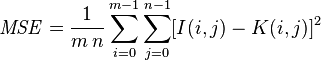
we will take the root square of the MSE 

Structural Similarity Index (SSIM):

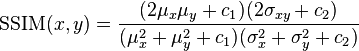

(x, y) location of the N x N window in each image, the mean of the pixel intensities in the x and y direction, the variance of intensities in the x and y direction, along with the covariance.

Unlike MSE, the SSIM value can vary between -1 and 1, where 1 indicates perfect similarity.

### RMSE, SSIM between two image A, image B
* image A: recoverd image (output of our model) convoluted with blur kernel 
    `res*K`
* image B: the blured image `y` (ground_truth iamge * `K`)

In [11]:
#make functions rmse , compare function between two images 

#evalute function
def rmse(imageA, imageB):

    # the 'Mean Squared Error' between the two images is the
    # sum of the squared difference between the two images;
    # NOTE: the two images must have the same dimension
    err = np.sum((imageA.astype("float") - imageB.astype("float")) ** 2)
    err /= float(imageA.shape[0] * imageA.shape[1])
    err= np.sqrt(err)
    # return the RMSE, the lower the error, the more "similar"
    # the two images are
    return err



def compare_images(imageA, imageB, title):
    # compute the mean squared error and structural similarity
    # index for the images
    m = rmse(imageA, imageB)
    s = ssim(imageA, imageB)
    # setup the figure
    fig = plt.figure(title)
    plt.suptitle("RMSE: %.2f, SSIM: %.4f" % (m, s))
    # show first image
    ax = fig.add_subplot(1, 2, 1)
    plt.imshow(imageA, cmap = 'gray')
    plt.axis("off")
    # show the second image
    ax = fig.add_subplot(1, 2, 2)
    plt.imshow(imageB, cmap = 'gray')
    plt.axis("off")
    # show the images
    plt.show()

In [22]:
#function to visualise our data 

def visual(y,x_gt,k,res):
    
    n_imgs=len(y)
    #from tensor to numpy
    x_hat=out_model_to_numpy(res,n_imgs)
    y_np,x_gt_np,k_np,kt_np=data_to_numpy(y,x_gt,k,kt)

    figsize: tuple=(25, 30)
    fig, axs = plt.subplots(nrows=n_imgs, ncols=5, figsize=figsize)
    plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.1, hspace=0.1)

    for id_img in range(n_imgs):

                #turn off axis number
                for i in range(5):
                    axs[id_img][i].axis('off')

                #convolute the recovered photo with blure-kernel    
                res_conv_k= fft_conv(x_hat[id_img], k_np[id_img])
                #unite the datatype
                res_conv_k=res_conv_k.astype(np.float32)
                #calculate MSE and SSIM between ground_truth and blurred image  
                
                mgt = rmse(x_gt_np[id_img], y_np[id_img])
                sgt = ssim(x_gt_np[id_img], y_np[id_img])

                #calculate MSE and SSIM between recoverd img convoluted with the blur kernel K and blurred image            
                mrk = rmse(res_conv_k, y_np[id_img])
                srk = ssim(res_conv_k, y_np[id_img]) 


    #             compare_images(res_conv_k, y_np, "input to model vs. output*K")

                # better visualization psf-shift
                if SHIFT:
                    kj = shift(k_np[id_img])
                else:
                    kj = k_np[id_img[id_img]]

                #plot the images    
                axs[id_img][0].imshow(kj, cmap='gray')
                axs[id_img][0].set_title("PSF")

                axs[id_img][1].imshow(x_gt_np[id_img], cmap='gray')
                axs[id_img][1].set_title(  "(Gt, Blurred)\n"+("RMSE: %.4f, SSIM: %.4f" % (mgt, sgt))+ "\nGround truth")

                axs[id_img][2].imshow(y_np[id_img], cmap='gray')
                axs[id_img][2].set_title("Blurred img (input)")

                axs[id_img][3].imshow(res_conv_k, cmap='gray')
                axs[id_img][3].set_title(("(Recov*blur_Ker, Blurred)\n"+("RMSE: %.4f, SSIM: %.4f" % (mrk, srk)) ) + "\nRecovered*bluer_kernel")

                axs[id_img][4].imshow(x_hat[id_img], cmap='gray')
                axs[id_img][4].set_title("Recovered (output)")

In [13]:
np.random.seed(42)
params=costumed_psf(rand_values=True,
                    num_params=5) 


100%|██████████| 5/5 [00:00<00:00,  9.23it/s]


In [14]:
print(params)

[[-7.70036790492211, 0.0, -2.560803634913157, 2.5, array([[0.00060466, 0.00057964, 0.00061887, ..., 0.00059873, 0.00058923,
        0.00061603],
       [0.0006191 , 0.000602  , 0.00060545, ..., 0.00057365, 0.00063128,
        0.00064009],
       [0.00064788, 0.00059131, 0.00055885, ..., 0.00054424, 0.00063582,
        0.00067767],
       ...,
       [0.00062629, 0.00059183, 0.00056889, ..., 0.00052658, 0.00064899,
        0.00065625],
       [0.00059953, 0.00056625, 0.00061074, ..., 0.00059917, 0.00060392,
        0.00062063],
       [0.00059976, 0.00056066, 0.00061186, ..., 0.000603  , 0.00057111,
        0.00060976]])], [-4.934045887359662, 0.0, -2.36514983269908, 2.5, array([[0.00149747, 0.00137666, 0.00138654, ..., 0.001309  , 0.00147446,
        0.00155114],
       [0.00145151, 0.00131105, 0.00141691, ..., 0.00138536, 0.00144094,
        0.00149145],
       [0.00139209, 0.00137594, 0.00138006, ..., 0.00127722, 0.00153961,
        0.00140652],
       ...,
       [0.00141047, 0.0013

In [15]:
for param in params:
    print(param[:-1])
#     for p in param[:-1]:
#         print(str(p))
        
    print('\n')

[-7.70036790492211, 0.0, -2.560803634913157, 2.5]


[-4.934045887359662, 0.0, -2.36514983269908, 2.5]


[-7.075185087646051, 0.0, -0.34083298881473034, 2.5]


[-4.55660620563237, 0.0, -1.0909050196757395, 2.5]


[-5.919107990605433, 0.0, -1.7876493034225185, 2.5]




In [16]:
# put data set into batches 
      
      
    
test_loader = get_dataloaders(data_files=test_files[:100],
                               dataset=BlurryImageDatasetOnTheFlySweet,
                               num_params=num_params,
                               batch_size=5,
                               shuffle=False,
                               drop_last=False,
                               params_filename="file_to_save_parm_psf",
                               noise_level_interval=(0.003,0.015),
                               noise_level=None,
                             psf_params=params,
                            rand_pfs= False )
                        



# files_dataset = dataset(file_name_list=test_files[:100],
#                         is_rgb=False,
#                         k_size=256,
#                         max_num_images=None,
#                         noise_level_interval=noise_level_interval,
#                         noise_level=noise_level,
#                         rand_pfs=rand_pfs)
#     if psf_params is not None:
#         files_dataset.set_psf_params(psf_params)
#     else: 
#         files_dataset.params_random_init(num_params)
    
    
#     data_loader = DataLoader(files_dataset, batch_size=batch_size, shuffle=shuffle, drop_last=drop_last)
    

In [17]:
np.random.seed(42)

# get the next iteration of dataset sample
y, x_gt, k, kt = next(iter(test_loader))

#get the recoverd photo from our model
with torch.no_grad():
    res = model(y, k, kt)

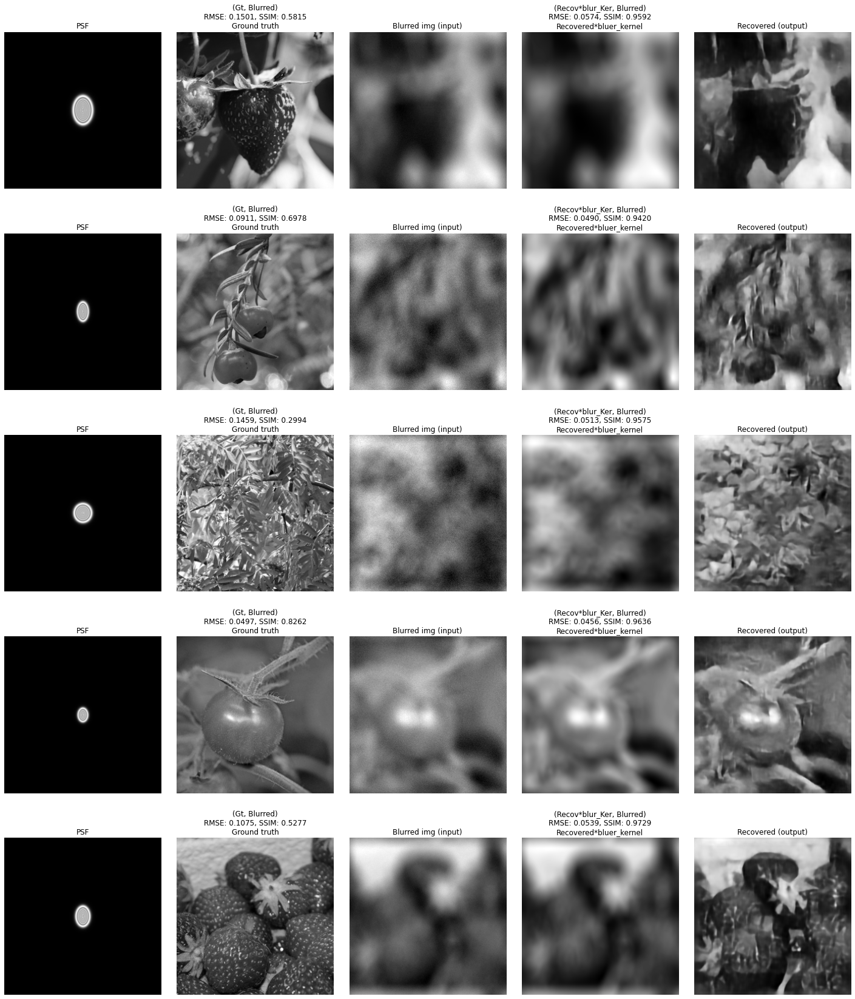

In [18]:
# visualize results
visual(y,x_gt,k,res)

# Test with other model: 'test_all_data-55'

In [16]:
#evalute our model



#initiate optimizer and a model 
rgdn = OptimizerRGDN(num_steps=5, is_rgb=False)
# optimizer = torch.optim.Optimizer()
optimizer = torch.optim.Adam(rgdn.parameters(), lr=5e-5)

#load the model
model, optimizer=load_trained_model(model=rgdn,
                                    opt=optimizer,
                                    name='test_all_data-55',
                                    model_path=MODEL_DIR
                                   )

# RGDN-SWEET-normed-param-d-GRAY-FFT-todel-after-server-crashed-noise-added-30
model.eval();

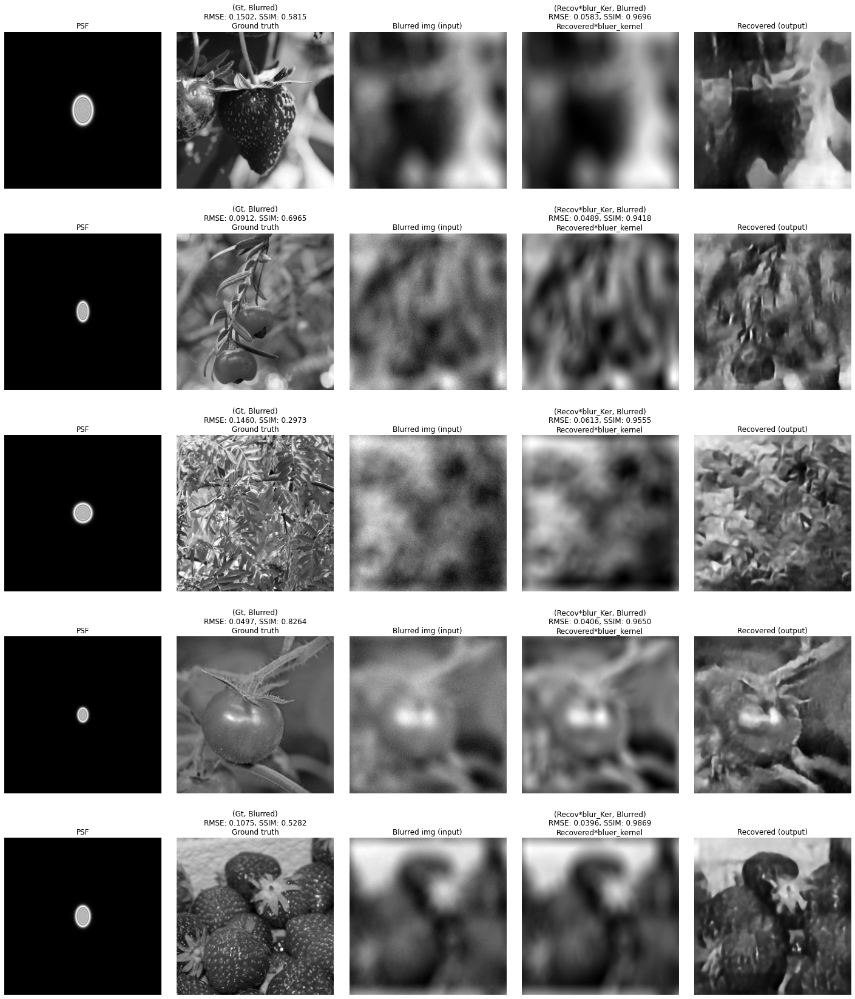

In [20]:
# put data set into batches 
      
      
    
test_loader = get_dataloaders(data_files=test_files[:100],
                               dataset=BlurryImageDatasetOnTheFlySweet,
                               num_params=num_params,
                               batch_size=5,
                               shuffle=False,
                               drop_last=False,
                               params_filename="file_to_save_parm_psf",
                               noise_level_interval=(0.003,0.015),
                               noise_level=None,
                             psf_params=params,
                            rand_pfs= False )

np.random.seed(42)

# get the next iteration of dataset sample
y, x_gt, k, kt = next(iter(test_loader))

#get the recoverd photo from our model
with torch.no_grad():
    res = model(y, k, kt)
    
# visualize results
visual(y,x_gt,k,res)

datawithout noise 


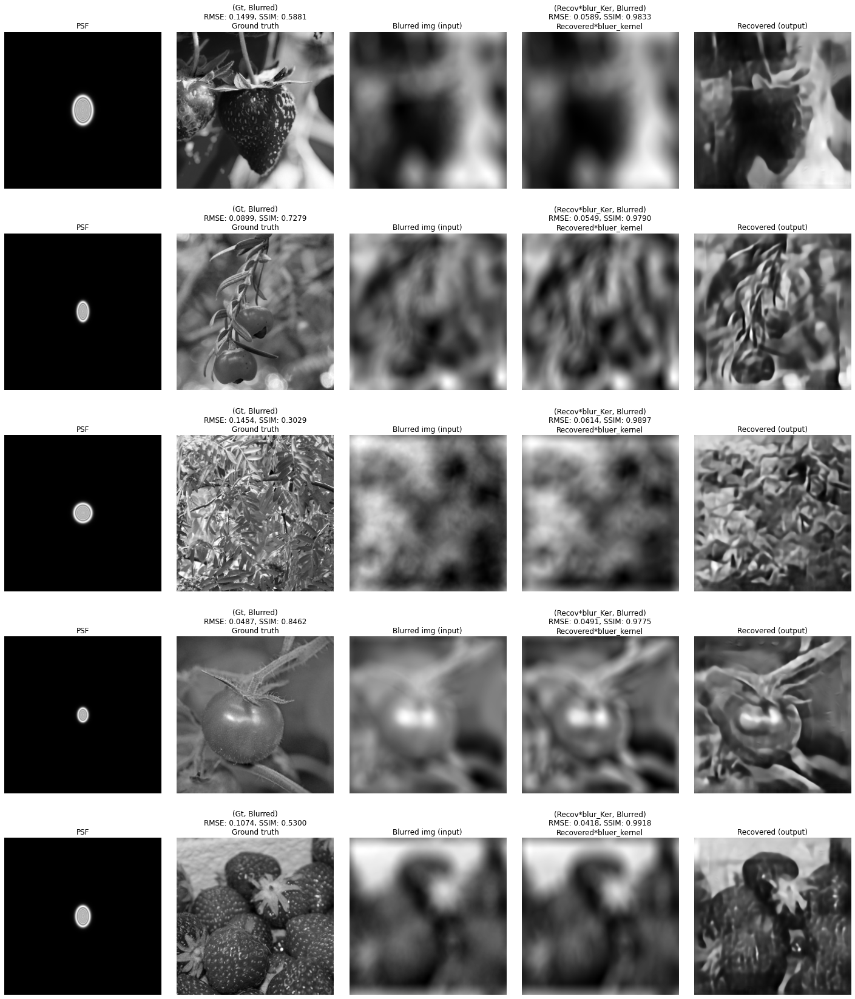

In [22]:
# put test_data_into_batches
#data_Set without noise !
np.random.seed(42)
test_loader_without_noise = get_dataloaders(data_files=test_files[:100],
                               dataset=BlurryImageDatasetOnTheFlySweet,
                               num_params=num_params,
                               batch_size=5,
                               shuffle=False,
                               drop_last=False,
                               params_filename="file_to_save_parm_psf",
                               noise_level_interval=None,
                               noise_level=None,
                              rand_pfs=False,
                            psf_params=params)

np.random.seed(42)
#Test the first batch 
# get the next iteration of dataset sample
y, x_gt, k, kt = next(iter(test_loader_without_noise))

#get the recoverd photo from our model
with torch.no_grad():
    res = model(y, k, kt)

#visualize results 
print ("data without noise ")
visual(y,x_gt,k,res)

In [ ]:
#evalute our model



#initiate optimizer and a model 
rgdn = OptimizerRGDN(num_steps=5, is_rgb=False)
# optimizer = torch.optim.Optimizer()
optimizer = torch.optim.Adam(rgdn.parameters(), lr=5e-5)

#load the model
model, optimizer=load_trained_model(model=rgdn,
                                    opt=optimizer,
                                    name='RGDN-SWEET-normed-param-d-GRAY-FFT-todel-after-server-crashed-noise-added-70',
                                    model_path=MODEL_DIR
                                   )

# RGDN-SWEET-normed-param-d-GRAY-FFT-todel-after-server-crashed-noise-added-30
model.eval()
1+1

# Now test the data without noise 

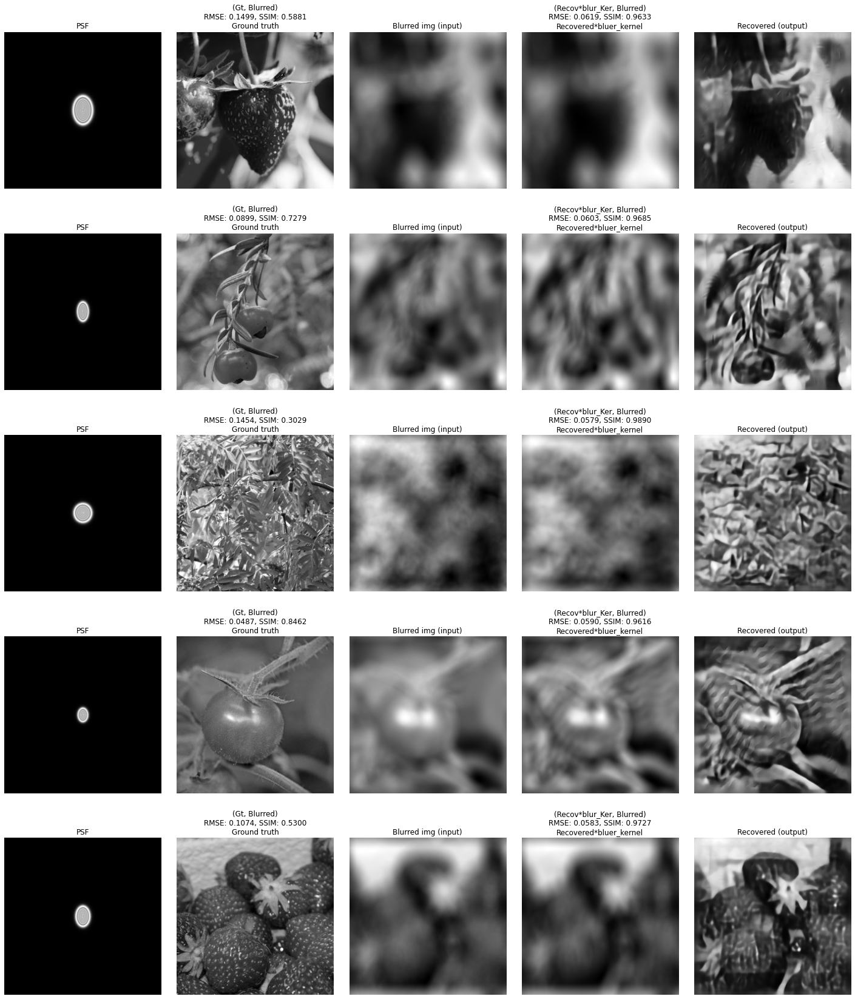

In [27]:
# put test_data_into_batches
#data_Set without noise !
np.random.seed(42)
test_loader_without_noise = get_dataloaders(data_files=test_files[:100],
                               dataset=BlurryImageDatasetOnTheFlySweet,
                               num_params=num_params,
                               batch_size=5,
                               shuffle=False,
                               drop_last=False,
                               params_filename="file_to_save_parm_psf",
                               noise_level_interval=None,
                               noise_level=None,
                              rand_pfs=False,
                            psf_params=params)

np.random.seed(42)
#Test the first batch 
# get the next iteration of dataset sample
y, x_gt, k, kt = next(iter(test_loader_without_noise))

#get the recoverd photo from our model
with torch.no_grad():
    res = model(y, k, kt)

#visualize results 
visual(y,x_gt,k,res)

# Test results again for model which was trained without noise, Data test without Noise

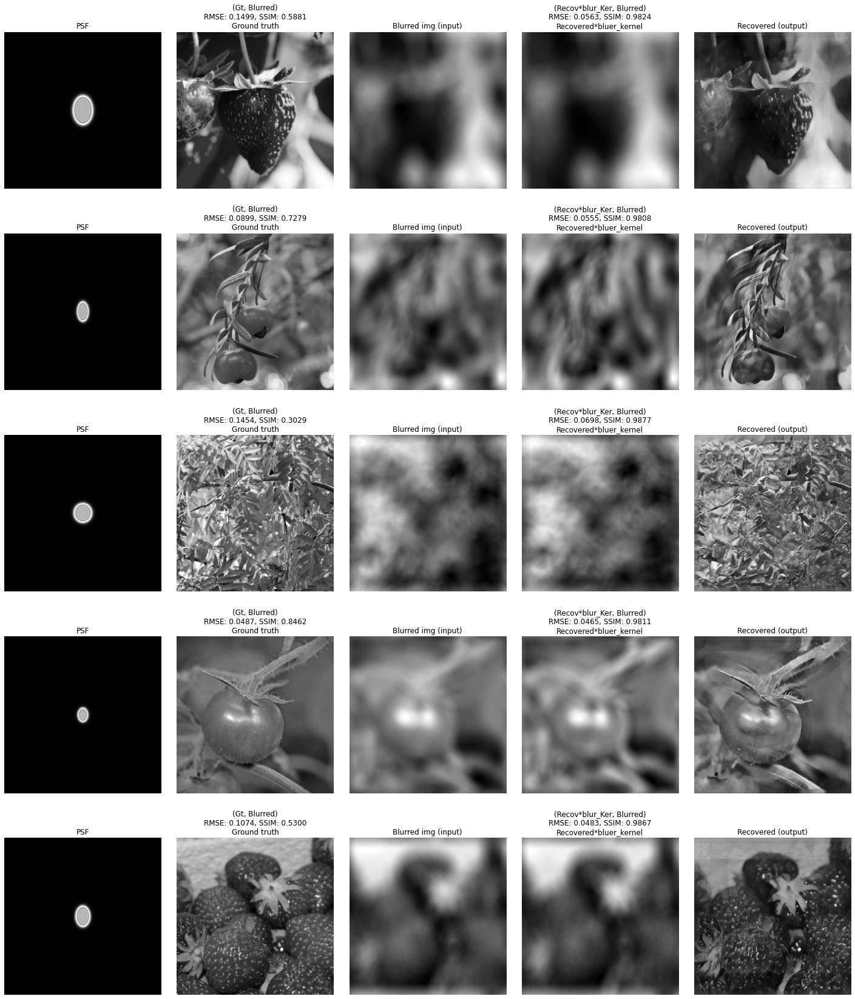

In [28]:

#initiate optimizer and a model 
rgdn = OptimizerRGDN(num_steps=5, is_rgb=False)
# optimizer = torch.optim.Optimizer()
optimizer = torch.optim.Adam(rgdn.parameters(), lr=5e-5)

#load the model
model, optimizer=load_trained_model(model=rgdn,
                                    opt=optimizer,
                                    name='RGDN-SWEET-normed-param-d-GRAY-FFT-todel-after-server-crashed-70',
                                    model_path=MODEL_DIR)


model.eval()

# put test_data_into_batches
#data_Set without noise !
np.random.seed(42)
test_loader_without_noise = get_dataloaders(data_files=test_files[:100],
                                            
                                           dataset=BlurryImageDatasetOnTheFlySweet,
                                           num_params=num_params,
                                           batch_size=5,
                                           shuffle=False,
                                           drop_last=False,
                                           params_filename="file_to_save_parm_psf",
                                           noise_level_interval=None,
                                           noise_level=None,
                                           rand_pfs=False,
                                           psf_params=params)

np.random.seed(42)
#Test the first batch 
# get the next iteration of dataset sample
y, x_gt, k, kt = next(iter(test_loader_without_noise))

#get the recoverd photo from our model
with torch.no_grad():
    res = model(y, k, kt)

#visualize results 
visual(y,x_gt,k,res)


# Test results again for model which was trained without noise, Data test With Noise!

100%|██████████| 5/5 [00:00<00:00, 12.30it/s]


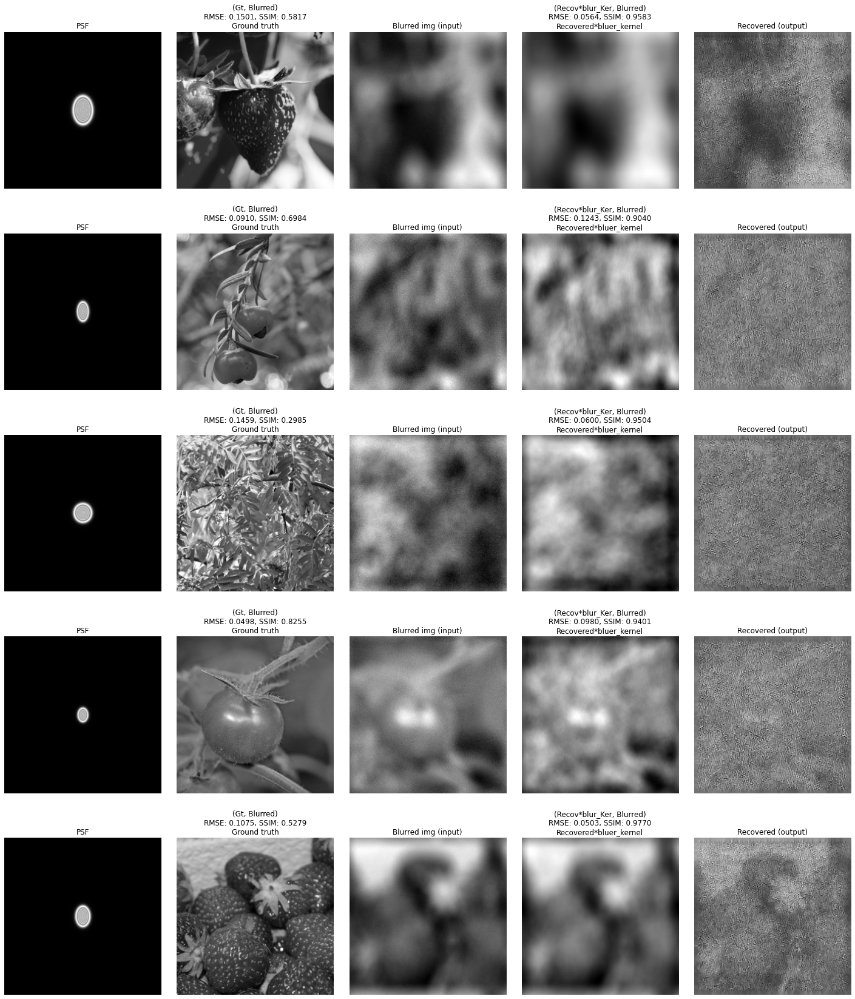

In [20]:
# put test_data_into_batches
#data_Set without noise !
np.random.seed(42)
test_loader = get_dataloaders(data_files=test_files[:100],
                               dataset=BlurryImageDatasetOnTheFlySweet,
                               num_params=num_params,
                               batch_size=5,
                               shuffle=False,
                               drop_last=False,
                               params_filename="file_to_save_parm_psf",
                               noise_level_interval=(0.003,0.015),
                               noise_level=None,
                              rand_pfs=False)

np.random.seed(42)
#Test the first batch 
# get the next iteration of dataset sample
y, x_gt, k, kt = next(iter(test_loader)

#get the recoverd photo from our model
with torch.no_grad():
    res = model(y, k, kt)

#visualize results 
visual(y,x_gt,k,res)


# Test with Wiener filter  

In [23]:
from skimage import color, data, restoration

def visual_wiener(y,x_gt,k,res, wiener_balance=0.1):
    n_imgs=len(y)
    #from tensor to numpy
    x_hat=out_model_to_numpy(res,n_imgs)
    y_np,x_gt_np,k_np,kt_np=data_to_numpy(y,x_gt,k,kt)

    figsize: tuple=(25, 30)
    fig, axs = plt.subplots(nrows=n_imgs, ncols=5, figsize=figsize)
    plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.1, hspace=0.1)

    for id_img in range(n_imgs):

                #turn off axis number
                for i in range(5):
                    axs[id_img][i].axis('off')
                
                #shift the psf
                if SHIFT:
                    kj = shift(k_np[id_img])
                else:
                    kj = k_np[id_img]
                    

                
                deconvolved_wiener = restoration.wiener(y_np[id_img], kj,wiener_balance)
                deconvolved_wiener = deconvolved_wiener.astype(np.float32)
                
#                 #convolute the recovered photo with blure-kernel    
#                 res_conv_k= fft_conv(x_hat[id_img], k_np[id_img])
#                 #unite the datatype
#                 res_conv_k=res_conv_k.astype(np.float32)
#                 #calculate MSE and SSIM between ground_truth and blurred image  
                
                rmsmodel = rmse(x_gt_np[id_img], x_hat[id_img])
                smodel = ssim(x_gt_np[id_img],  x_hat[id_img])

                #calculate MSE and SSIM between recoverd img convoluted with the blur kernel K and blurred image            
                rmswiener = rmse(x_gt_np[id_img],deconvolved_wiener)
                swiener= ssim(x_gt_np[id_img],deconvolved_wiener)


    #             compare_images(res_conv_k, y_np, "input to model vs. output*K")

                
                

                #plot the images    
                axs[id_img][0].imshow(kj, cmap='gray')
                axs[id_img][0].set_title("PSF")

                axs[id_img][1].imshow(x_gt_np[id_img], cmap='gray')
                axs[id_img][1].set_title("Ground truth")

                axs[id_img][2].imshow(y_np[id_img], cmap='gray')
                axs[id_img][2].set_title("Blurred img (input)")

                axs[id_img][3].imshow(deconvolved_wiener, cmap='gray')
                axs[id_img][3].set_title("Recovered by Wiener\n"+("values between(Wiener_rec, GT)\n"+("RMSE: %.4f, SSIM: %.4f" % (rmswiener, swiener))))

                axs[id_img][4].imshow(x_hat[id_img], cmap='gray')
                axs[id_img][4].set_title("Recovered by DNN\n" + "values between(DNN_rec, GT)\n"+("RMSE: %.4f, SSIM: %.4f" % (rmsmodel, smodel)))
    
    
    
    
    

In [24]:
#load the model
model, optimizer=load_trained_model(model=rgdn,
                                    opt=optimizer,
                                    name='test_all_data-55',
                                    model_path=MODEL_DIR)


model.eval()

test_loader = get_dataloaders(data_files=test_files[:100],
                               dataset=BlurryImageDatasetOnTheFlySweet,
                               num_params=num_params,
                               batch_size=5,
                               shuffle=False,
                               drop_last=False,
                               params_filename="file_to_save_parm_psf",
                               noise_level_interval=(0.003,0.015),
                               noise_level=None,
                             psf_params=params,
                            rand_pfs= False )

np.random.seed(42)

# get the next iteration of dataset sample
y, x_gt, k, kt = next(iter(test_loader))

#get the recoverd photo from our model
with torch.no_grad():
    res = model(y, k, kt)

Model was trained with Noise, image input with noise


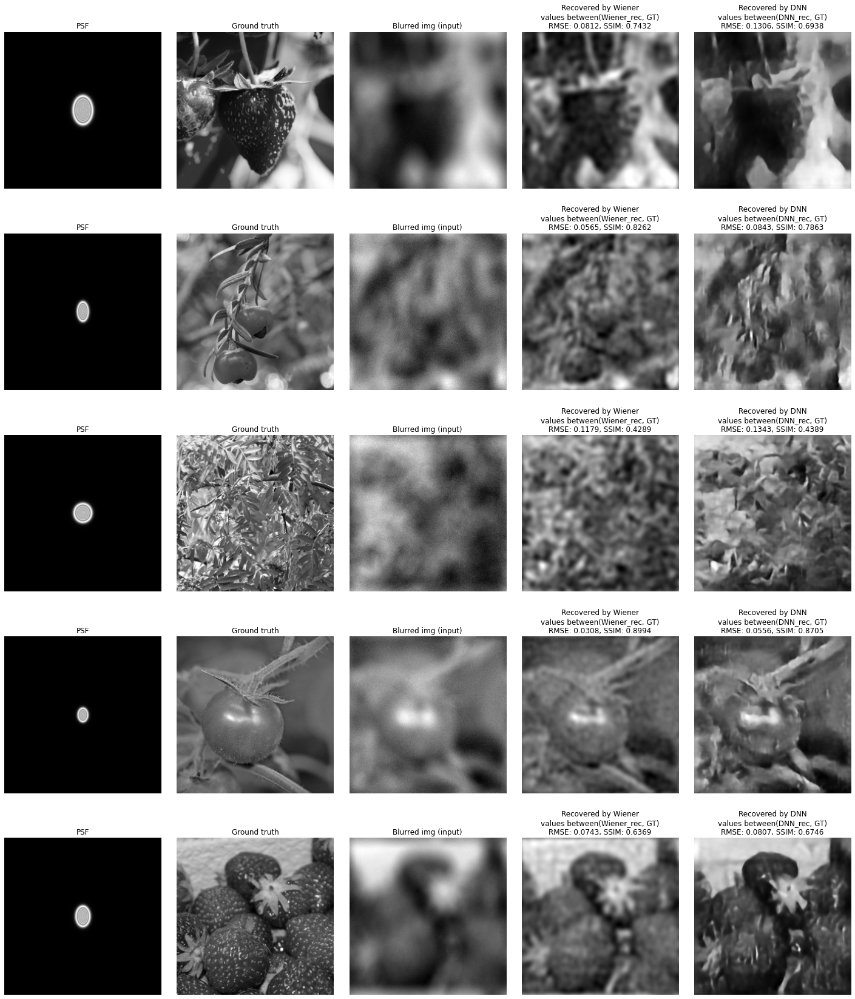

In [28]:
# visualize results 
print("Model was trained with Noise, image input with noise")
visual_wiener(y,x_gt,k,res)

Model was trained with Noise, image input withOUT noise


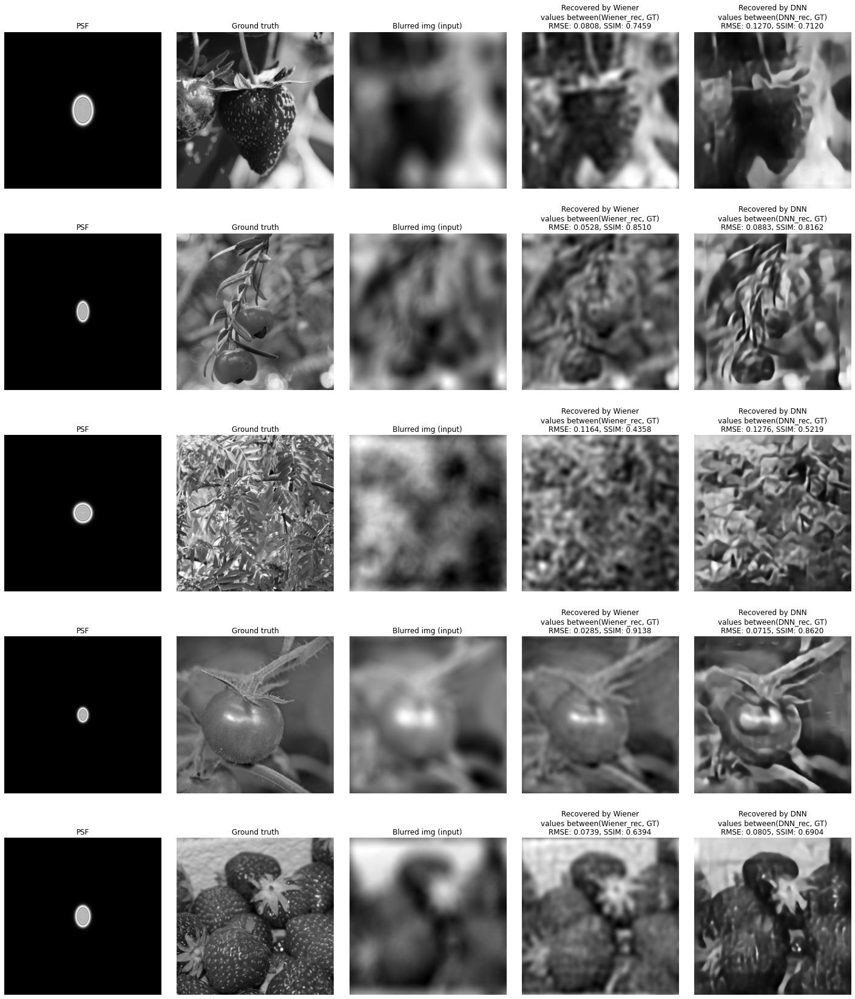

In [29]:
test_loader = get_dataloaders(data_files=test_files[:100],
                               dataset=BlurryImageDatasetOnTheFlySweet,
                               num_params=num_params,
                               batch_size=5,
                               shuffle=False,
                               drop_last=False,
                               params_filename="file_to_save_parm_psf",
                               noise_level_interval=None,
                               noise_level=None,
                             psf_params=params,
                            rand_pfs= False )

np.random.seed(42)

# get the next iteration of dataset sample
y, x_gt, k, kt = next(iter(test_loader))

#get the recoverd photo from our model
with torch.no_grad():
    res = model(y, k, kt)
    
# visualize results 
print("Model was trained with Noise, image input withOUT noise")
visual_wiener(y,x_gt,k,res)

Model was trained with Noise, image input withOUT noise, Wiener_balance = 0


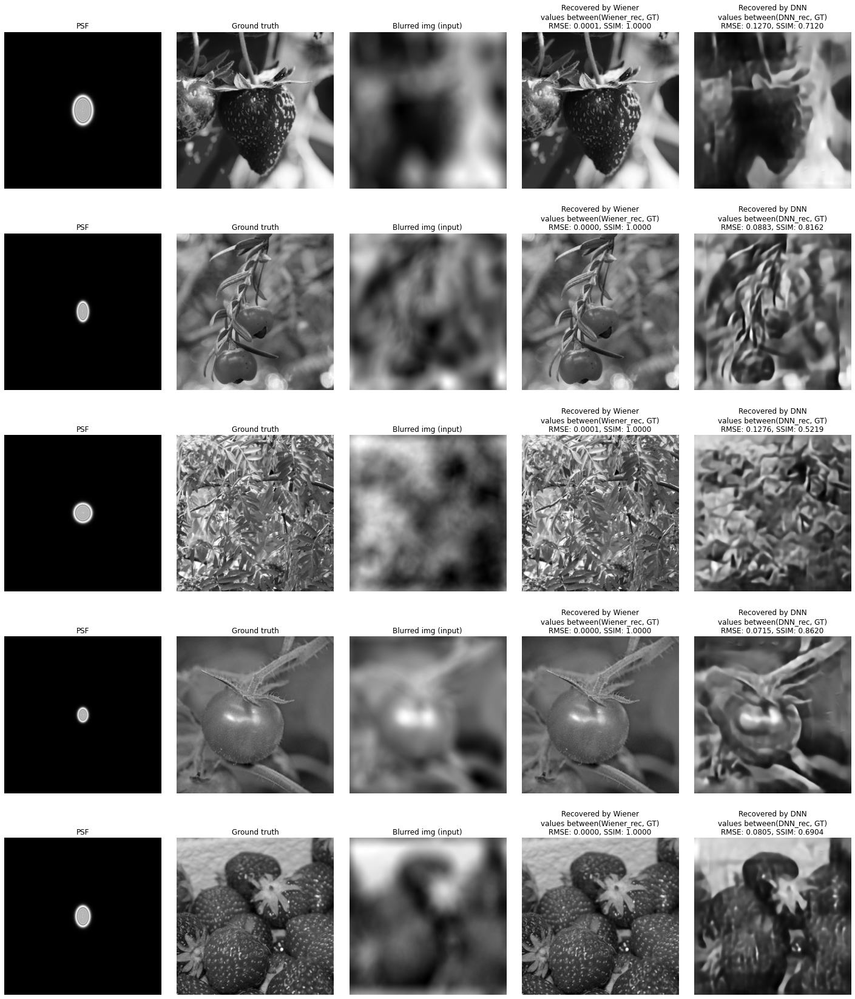

In [36]:
print("Model was trained with Noise, image input withOUT noise, Wiener_balance = 0")
visual_wiener(y,x_gt,k,res, wiener_balance=0.0)

Model was trained with Noise, image input withOUT noise


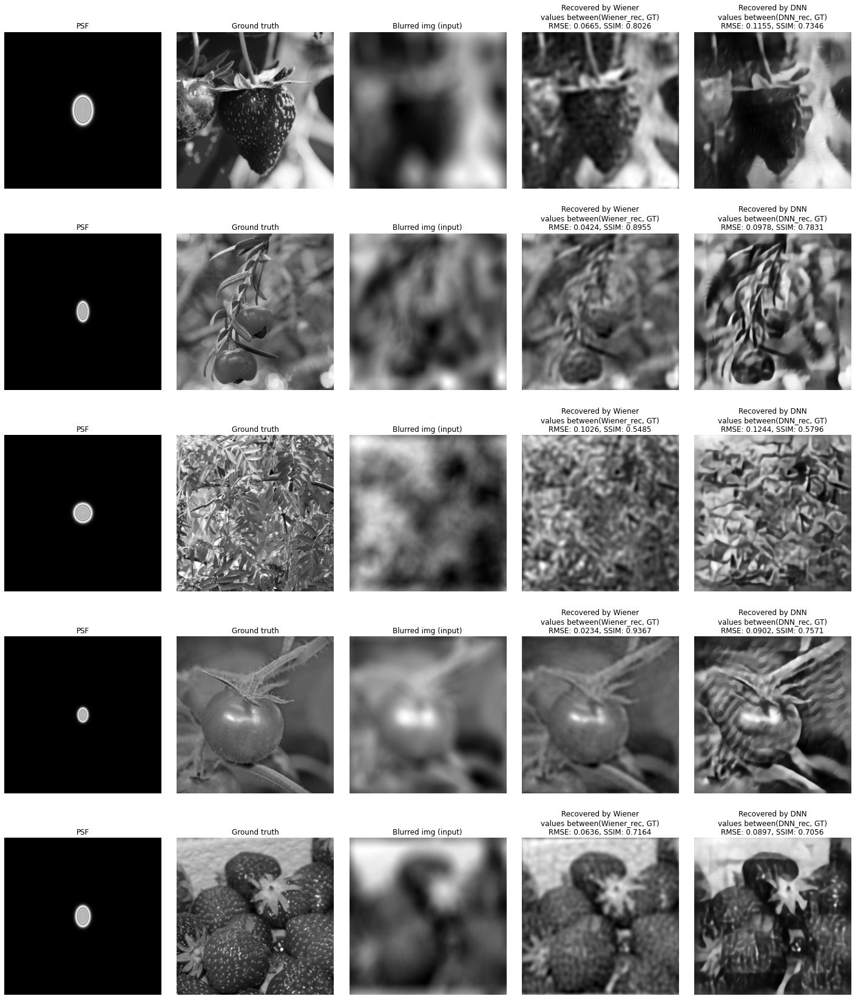

In [73]:
#load the model
model, optimizer=load_trained_model(model=rgdn,
                                    opt=optimizer,
                                    name='RGDN-SWEET-normed-param-d-GRAY-FFT-todel-after-server-crashed-noise-added-70',
                                    model_path=MODEL_DIR)


model.eval()

test_loader = get_dataloaders(data_files=test_files[:100],
                               dataset=BlurryImageDatasetOnTheFlySweet,
                               num_params=num_params,
                               batch_size=5,
                               shuffle=False,
                               drop_last=False,
                               params_filename="file_to_save_parm_psf",
                               noise_level_interval=(0.003,0.015),
                               noise_level=None,
                             psf_params=params,
                            rand_pfs= False )

np.random.seed(42)

# get the next iteration of dataset sample
y, x_gt, k, kt = next(iter(test_loader))

#get the recoverd photo from our model
with torch.no_grad():
    res = model(y, k, kt)

print("Model was trained with Noise, image input withOUT noise")
visual_wiener(y,x_gt,k,res)

# Test with images that we assume the network never seen them 
# like images of people 

In [45]:

from PIL import Image

basewidth = 256
img = Image.open('dataFiles/Linnaeus 5 256X256/test_new_photos/people4.png')

img = img.resize((256,256))

img.save('dataFiles/Linnaeus 5 256X256/test_new_photos/people4.jpg')




In [48]:

#if train & test files in diffrent folders

test_dir = Path(os.path.join(DATA_DIR, 'test_new_photos'))
test_files = list(test_dir.rglob('*.jpg'))

print(test_files)
# data_files=test_files[:100],
#                                dataset=BlurryImageDatasetOnTheFlySweet,
#                                num_params=num_params,
#                                batch_size=5,
#                                shuffle=False,
#                                drop_last=False,
#                                params_filename="file_to_save_parm_psf",
#                                noise_level_interval=(0.003,0.015),
#                                noise_level=None,
#                               rand_pfs=False
# put test_data_into_batches
np.random.seed(42)
files_dataset = BlurryImageDatasetOnTheFlySweet(file_name_list=test_files,
                                                is_rgb=False,
                                                k_size=256,
                                                max_num_images=None,
                                                noise_level_interval=(0.003,0.015),
                                                noise_level=None,
                                                rand_pfs=False)

files_dataset.set_psf_params(params)

    
    
data_loader = DataLoader(files_dataset, batch_size=5, shuffle=False, drop_last=False)
#     save_params(params_filename, files_dataset)
    






# get the next iteration of dataset sample
y, x_gt, k, kt = next(iter(data_loader))




#initiate optimizer and a model 
rgdn = OptimizerRGDN(num_steps=5, is_rgb=False)
# optimizer = torch.optim.Optimizer()
optimizer = torch.optim.Adam(rgdn.parameters(), lr=5e-5)

#load the model
model, optimizer=load_trained_model(model=rgdn,
                                    opt=optimizer,
                                    name='RGDN-SWEET-normed-param-d-GRAY-FFT-todel-after-server-crashed-noise-added-70',
                                    model_path=MODEL_DIR
                                   )

# RGDN-SWEET-normed-param-d-GRAY-FFT-todel-after-server-crashed-noise-added-30
model.eval()
#get the recoverd photo from our model
with torch.no_grad():
    res = model(y, k, kt)

[PosixPath('dataFiles/Linnaeus 5 256X256/test_new_photos/people2.jpg'), PosixPath('dataFiles/Linnaeus 5 256X256/test_new_photos/person1.jpg'), PosixPath('dataFiles/Linnaeus 5 256X256/test_new_photos/person2.jpg'), PosixPath('dataFiles/Linnaeus 5 256X256/test_new_photos/people1.jpg'), PosixPath('dataFiles/Linnaeus 5 256X256/test_new_photos/people4.jpg')]


wiener_balance  0.6
Model was trained with Noise, image input with noise


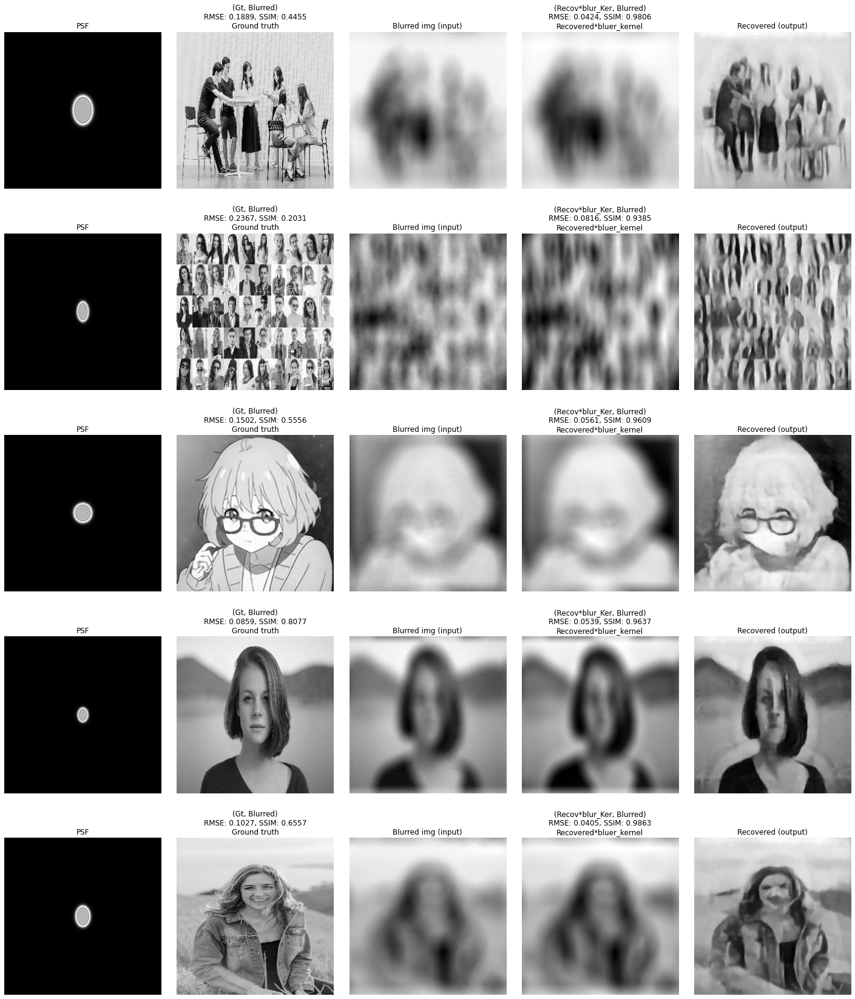

In [49]:
wb = 0.6
# visual_wiener(y,x_gt,k,res, wiener_balance=wb)
visual(y,x_gt,k,res)
print("wiener_balance ",wb)

print("Model was trained with Noise, image input with noise")

wiener_balance  0.5
Model was trained with Noise, image input with noise


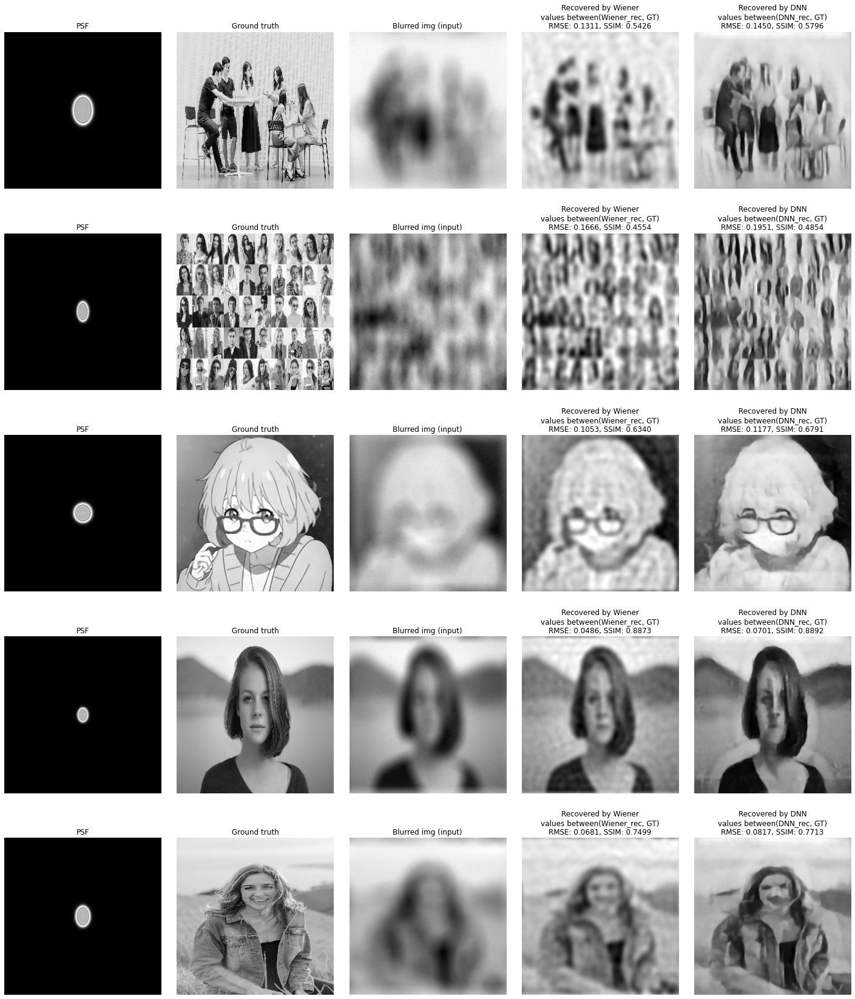

In [53]:
visual_wiener
wb = 0.5
# visual_wiener(y,x_gt,k,res, wiener_balance=wb)
visual_wiener(y,x_gt,k,res)
print("wiener_balance ",wb)

print("Model was trained with Noise, image input with noise")

# test with train test

Model was trained with Noise, image input with noise


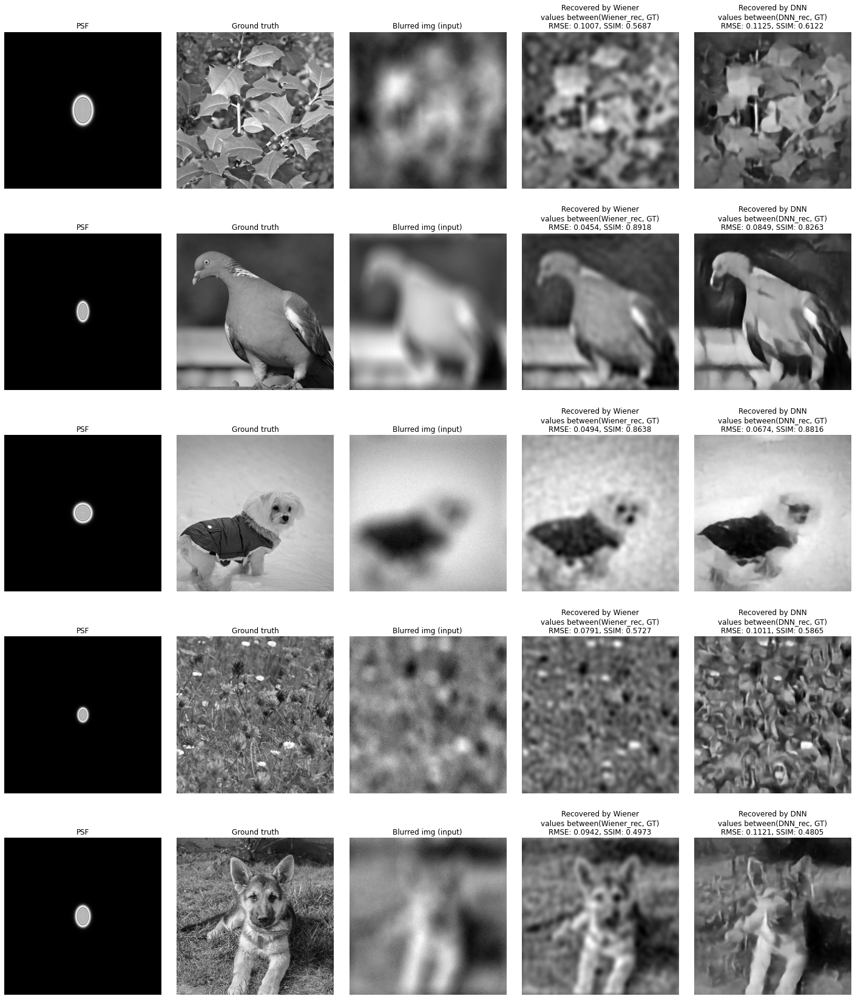

In [67]:
test_loader = get_dataloaders(data_files=train_files,
                               dataset=BlurryImageDatasetOnTheFlySweet,
                               num_params=num_params,
                               batch_size=5,
                               shuffle=True,
                               drop_last=False,
                               params_filename="file_to_save_parm_psf",
                               noise_level_interval=(0.003,0.015),
                               noise_level=None,
                             psf_params=params,
                            rand_pfs= False )


# np.random.seed(42)
# get the next iteration of dataset sample
y, x_gt, k, kt = next(iter(test_loader))

#get the recoverd photo from our model
with torch.no_grad():
    res = model(y, k, kt)
    
# visualize results 
wb=0.1 #wiener_balance
print("Model was trained with Noise, image input with noise")
visual_wiener(y,x_gt,k,res,wiener_balance=wb)

Model was trained with Noise, image input with noise


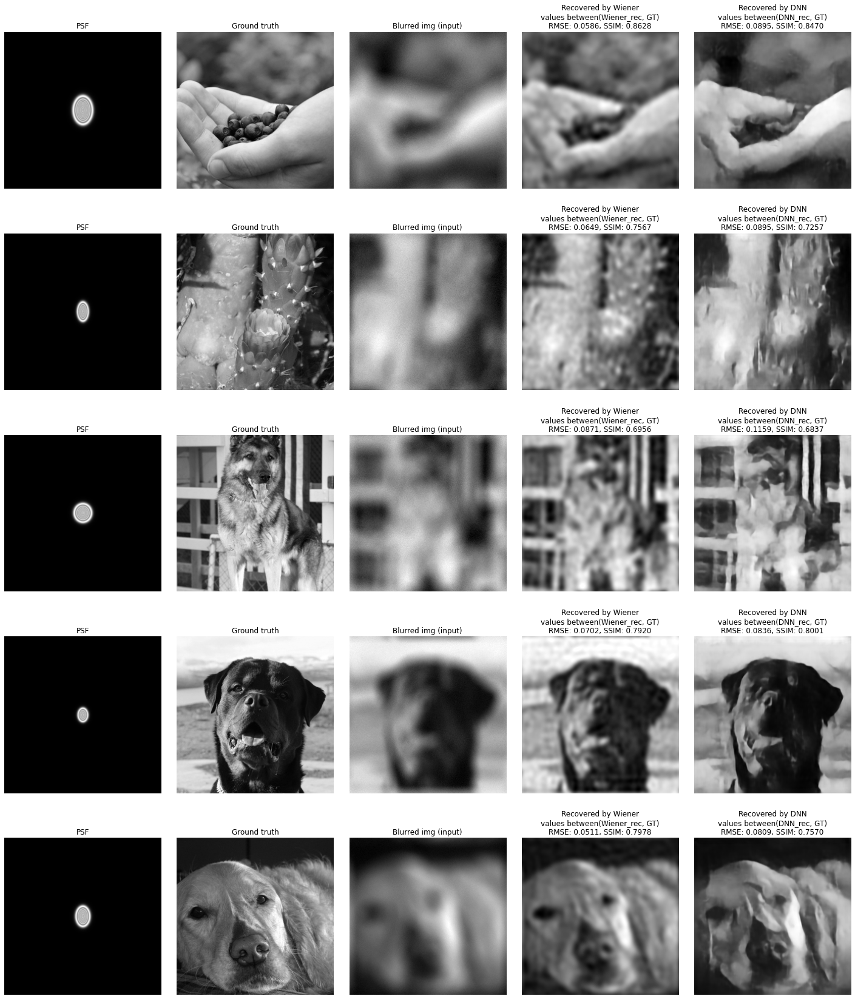

In [66]:

test_loader = get_dataloaders(data_files=train_files,
                               dataset=BlurryImageDatasetOnTheFlySweet,
                               num_params=num_params,
                               batch_size=5,
                               shuffle=True,
                               drop_last=False,
                               params_filename="file_to_save_parm_psf",
                               noise_level_interval=(0.003,0.015),
                               noise_level=None,
                             psf_params=params,
                            rand_pfs= False )


np.random.seed(42)
# get the next iteration of dataset sample
y, x_gt, k, kt = next(iter(test_loader))

#get the recoverd photo from our model
with torch.no_grad():
    res = model(y, k, kt)
    
# visualize results 
wb=0.1 #wiener_balance
print("Model was trained with Noise, image input with noise")
visual_wiener(y,x_gt,k,res,wiener_balance=wb)

Model was trained with Noise, image input withOUT noise


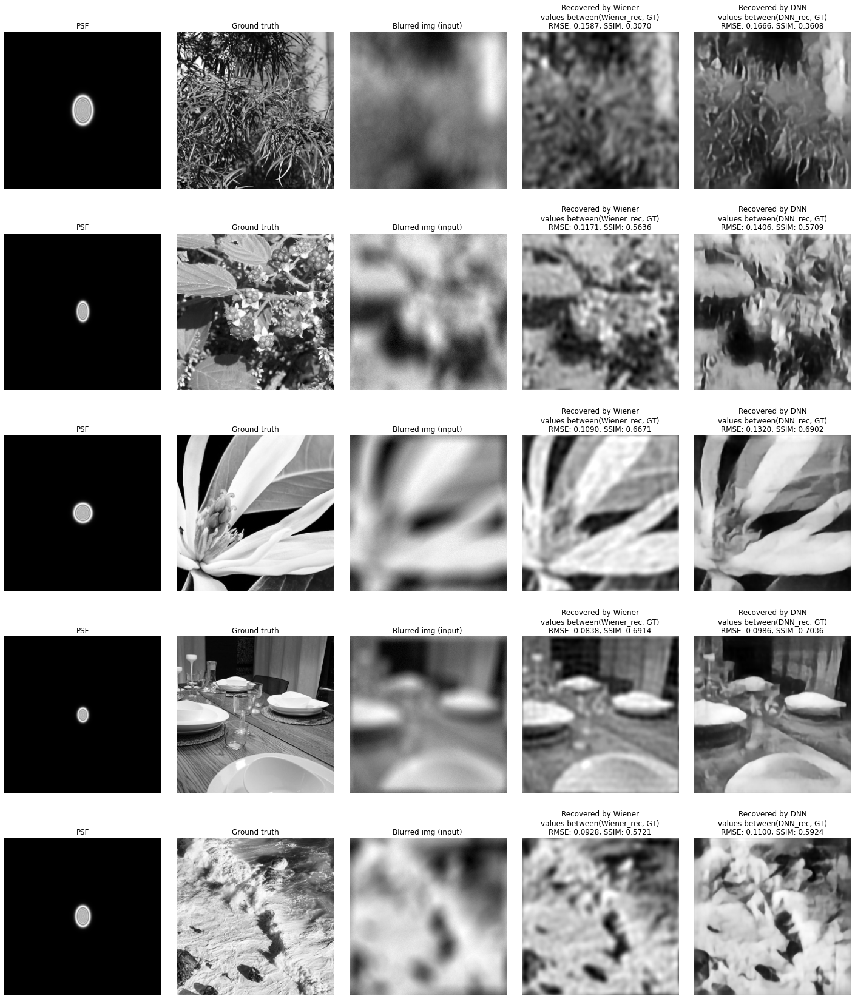

In [62]:
wb=0.1 #wiener_balance
print("Model was trained with Noise, image input withOUT noise")
visual_wiener(y,x_gt,k,res,wiener_balance=wb)

# Let's try Unsupervised Wiener¶

In [67]:
from skimage import color, data, restoration

def visual_unsupervised_wiener(y,x_gt,k,res):
    n_imgs=len(y)
    #from tensor to numpy
    x_hat=out_model_to_numpy(res,n_imgs)
    y_np,x_gt_np,k_np,kt_np=data_to_numpy(y,x_gt,k,kt)

    figsize: tuple=(25, 30)
    fig, axs = plt.subplots(nrows=n_imgs, ncols=5, figsize=figsize)
    plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.1, hspace=0.1)

    for id_img in range(n_imgs):

                #turn off axis number
                for i in range(5):
                    axs[id_img][i].axis('off')
                
                #shift the psf
                if SHIFT:
                    kj = shift(k_np[id_img])
                else:
                    kj = k_np[id_img]
                    

                
#                 deconvolved_wiener = restoration.wiener(y_np[id_img], kj,0.05)
                deconvolved_wiener,_ = restoration.unsupervised_wiener(y_np[id_img], kj)
                deconvolved_wiener = deconvolved_wiener.astype(np.float32)
                
#                 #convolute the recovered photo with blure-kernel    
#                 res_conv_k= fft_conv(x_hat[id_img], k_np[id_img])
#                 #unite the datatype
#                 res_conv_k=res_conv_k.astype(np.float32)
#                 #calculate MSE and SSIM between ground_truth and blurred image  
                
                rmsmodel = rmse(x_gt_np[id_img], x_hat[id_img])
                smodel = ssim(x_gt_np[id_img],  x_hat[id_img])

                #calculate MSE and SSIM between recoverd img convoluted with the blur kernel K and blurred image            
                rmswiener = rmse(x_gt_np[id_img],deconvolved_wiener)
                swiener= ssim(x_gt_np[id_img],deconvolved_wiener)


    #             compare_images(res_conv_k, y_np, "input to model vs. output*K")

                
                

                #plot the images    
                axs[id_img][0].imshow(kj, cmap='gray')
                axs[id_img][0].set_title("PSF")

                axs[id_img][1].imshow(x_gt_np[id_img], cmap='gray')
                axs[id_img][1].set_title("Ground truth")

                axs[id_img][2].imshow(y_np[id_img], cmap='gray')
                axs[id_img][2].set_title("Blurred img (input)")

                axs[id_img][3].imshow(deconvolved_wiener, cmap='gray')
                axs[id_img][3].set_title("Recovered by unsupervised_wiener\n"+("values between(Wiener_rec, GT)\n"+("RMSE: %.4f, SSIM: %.4f" % (rmswiener, swiener))))

                axs[id_img][4].imshow(x_hat[id_img], cmap='gray')
                axs[id_img][4].set_title("Recovered by DNN\n" + "values between(DNN_rec, GT)\n"+("RMSE: %.4f, SSIM: %.4f" % (rmsmodel, smodel)))
    
    
    
    
    

Model was trained with Noise, image input with noise


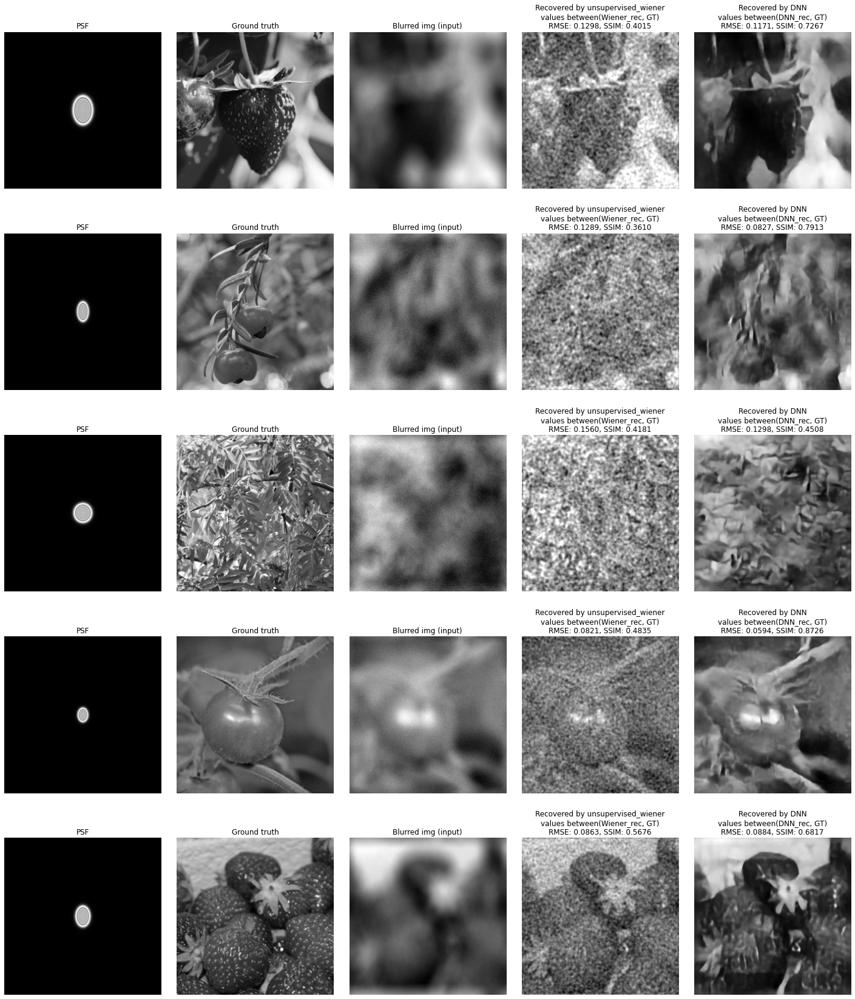

In [68]:
# visualize results 
print("Model was trained with Noise, image input with noise")
visual_unsupervised_wiener(y,x_gt,k,res)

# Again with model which was trained with noise : 

In [22]:
#load the model
model, optimizer=load_trained_model(model=rgdn,
                                    opt=optimizer,
                                    name='RGDN-SWEET-normed-param-d-GRAY-FFT-todel-after-server-crashed-noise-added-70',
                                    model_path=MODEL_DIR)


## The results for step = 10 ,data test with noise

In [32]:

#set number of steps for the model = 10 // 5 was chosen when trained
model.set_num_steps(10)


100%|██████████| 5/5 [00:00<00:00, 14.47it/s]


10


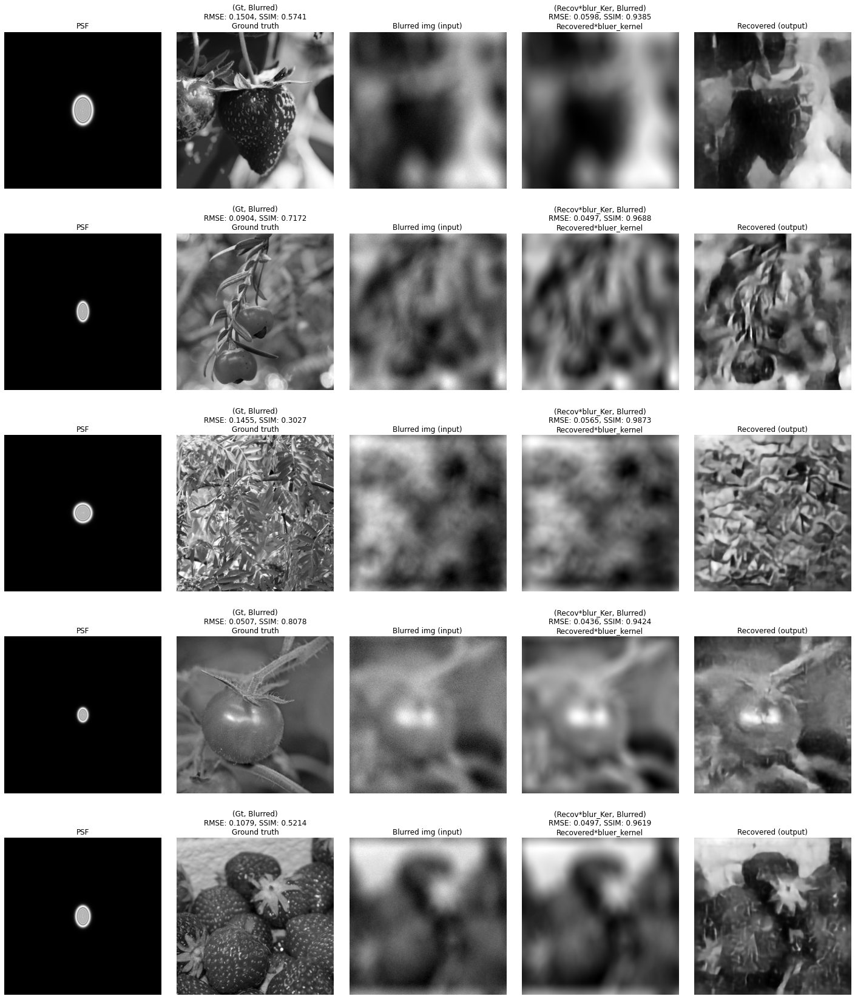

In [33]:
np.random.seed(42)

test_loader = get_dataloaders(data_files=test_files[:100],
                               dataset=BlurryImageDatasetOnTheFlySweet,
                               num_params=num_params,
                               batch_size=5,
                               shuffle=False,
                               drop_last=False,
                               params_filename="file_to_save_parm_psf",
                               noise_level_interval=(0.003,0.015),
                               noise_level=None,
                               rand_pfs=False)


#Test the first batch 
# model.set_num_steps(10)
# get the next iteration of dataset sample
y, x_gt, k, kt = next(iter(test_loader))


#get the recoverd photo from our model
with torch.no_grad():
    res = model(y, k, kt)
print(len(res))
#visualize results 
visual(y,x_gt,k,res)


# results for model with 10 step, data test without noise 

100%|██████████| 5/5 [00:00<00:00, 14.08it/s]


10


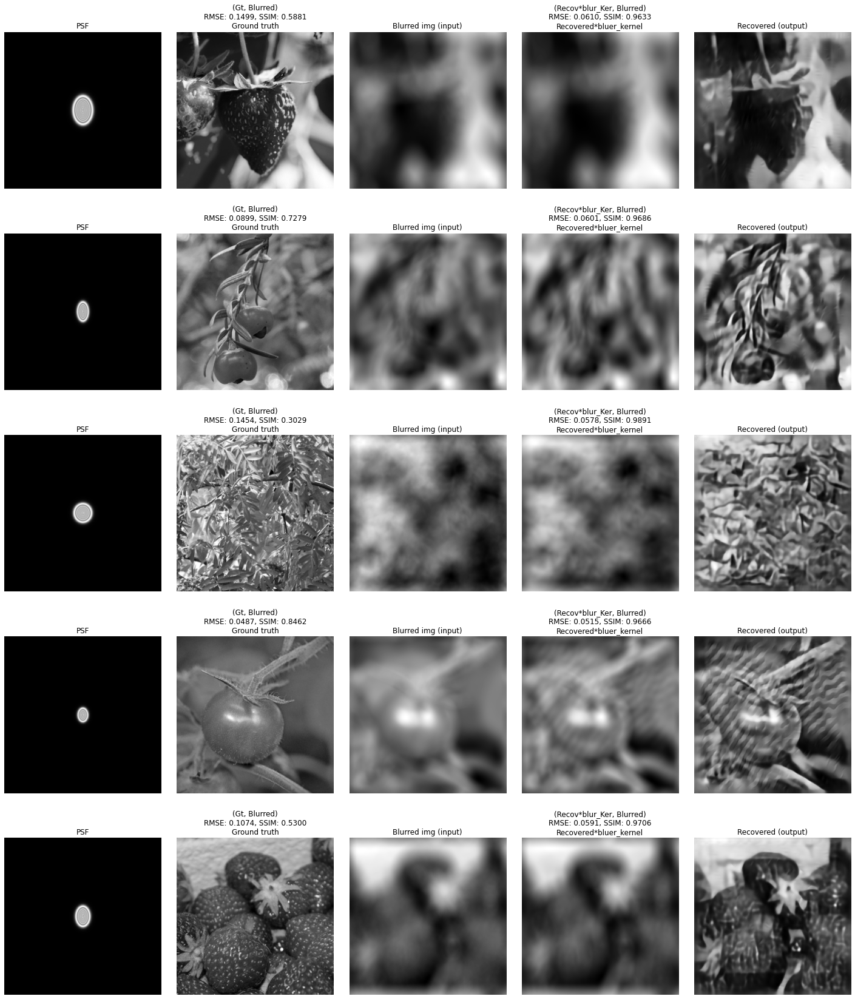

In [34]:
np.random.seed(42)

test_loader = get_dataloaders(data_files=test_files[:100],
                               dataset=BlurryImageDatasetOnTheFlySweet,
                               num_params=num_params,
                               batch_size=5,
                               shuffle=False,
                               drop_last=False,
                               params_filename="file_to_save_parm_psf",
                               noise_level_interval=None,
                               noise_level=None,
                               rand_pfs=False)


#Test the first batch 
# model.set_num_steps(10)
# get the next iteration of dataset sample
y, x_gt, k, kt = next(iter(test_loader))


#get the recoverd photo from our model
with torch.no_grad():
    res = model(y, k, kt)
print(len(res))
#visualize results 
visual(y,x_gt,k,res)

### Now let's test a 100 batches from test data,and see RMSE, SSIM between
* ground_image and blurred image
* (output of mode * K) and blurred image

In [14]:
test_loader = get_dataloaders(data_files=test_files[:100],
                               dataset=BlurryImageDatasetOnTheFlySweet,
                               num_params=num_params,
                               batch_size=5,
                               shuffle=False,
                               drop_last=False,
                               params_filename="file_to_save_parm_psf",
                               noise_level_interval=(0.003,0.015),
                               noise_level=None)




          
# create an Empty pandas DataFrame 
df = pd.DataFrame()
# print("SSIM & RMSE between Ground_Truth image and blurred image ")
# append data in columns to an empty pandas DataFrame
df['RMSE(GT,blurred)'] = []
df['RMSE(Res*K, blurred)'] = []
df['SSIM(GT,blurred)'] = []
df['SSIM(Res*K, blurred)'] = []

#batch size
n_imgs=5


#loop for first 4 batches

for y, x_gt, k, kt in tqdm(test_loader):
# for i in range(100):
#     i=i+1
#     y, x_gt, k, kt = next(iter(test_loader))
    with torch.no_grad():
        res=model(y,k,kt)
    x_hat=out_model_to_numpy(res,n_imgs)
    y_np,x_gt_np,k_np,kt_np=data_to_numpy(y,x_gt,k,kt)

    for id_img in range(n_imgs):              

        #recoverd img convoluted with the blur kernel K
        res_conv_k= fft_conv(x_hat[id_img], k_np[id_img])
        #unite datatupe 
        res_conv_k=res_conv_k.astype(np.float32)

        #calculate MSE and SSIM between ground_truth and blurred image    
        mgt = rmse(x_gt_np[id_img], y_np[id_img])
        sgt = ssim(x_gt_np[id_img], y_np[id_img])

        #calculate MSE and SSIM between recoverd img convoluted with the blur kernel K and blurred image            
        mrk = rmse(res_conv_k, y_np[id_img])
        srk = ssim(res_conv_k, y_np[id_img]) 

        #add the result to our data frame 
        df=df.append({'RMSE(GT,blurred)' : mgt, 'SSIM(GT,blurred)': sgt,
                      'RMSE(Res*K, blurred)': mrk,
                     'SSIM(Res*K, blurred)': srk}, 
                    ignore_index = True)

#         compare_images(x_gt_np[id_img],y_np[id_img], "input to model vs. output*K")

df.to_csv('RMSE_SSIM_100_img.csv')             
df


100%|██████████| 20/20 [10:03<00:00, 30.19s/it]


,"RMSE(GT,blurred)","RMSE(Res*K, blurred)","SSIM(GT,blurred)","SSIM(Res*K, blurred)"
0,0.131352,0.054207,0.610122,0.957556
1,0.091070,0.048566,0.697307,0.942079
2,0.139368,0.070524,0.306544,0.960671
3,0.055058,0.046221,0.827647,0.976868
4,0.107563,0.052502,0.527294,0.972293
...,...,...,...,...
95,0.194614,0.056766,0.346292,0.967524
96,0.167513,0.048774,0.385962,0.956548
97,0.200755,0.056610,0.329119,0.957815
98,0.105809,0.051086,0.701421,0.968733


In [15]:
#mean values 

dfMean=df.mean()
print("100 images were tested\nThe mean values are:")
dfMean

100 images were tested
The mean values are:


RMSE(GT,blurred)        0.124866
RMSE(Res*K, blurred)    0.053682
SSIM(GT,blurred)        0.557179
SSIM(Res*K, blurred)    0.955855
dtype: float64

In [16]:
df2=pd.DataFrame()
# row=['min',df["RMSE(GT,blurred)"].min(),df["RMSE(Res*K, blurred)"].min(),"SSIM(GT,blurred)"].min(),"SSIM(Res*K, blurred)"].min()]
df2['-']=["Minimum values:"]
df2
df2["RMSE(GT,blurred)"]=[df["RMSE(GT,blurred)"].min()]
df2["RMSE(Res*K, blurred)"]=[df["RMSE(Res*K, blurred)"].min()]
df2["SSIM(GT,blurred)"]=[df["SSIM(GT,blurred)"].min()]
df2["SSIM(Res*K, blurred)"]=[df["SSIM(Res*K, blurred)"].min()]


df2

df2=df2.append({'-':'Maximum values:',
                'RMSE(GT,blurred)' : df["RMSE(GT,blurred)"].max(),
                'SSIM(GT,blurred)': df["SSIM(GT,blurred)"].max(),
                'RMSE(Res*K, blurred)': df["RMSE(Res*K, blurred)"].max(),
                 'SSIM(Res*K, blurred)': df["SSIM(Res*K, blurred)"].max()}, 
                    ignore_index = True)

df2=df2.append({'-':'Mean values (100 imgs):',
                'RMSE(GT,blurred)' : df["RMSE(GT,blurred)"].mean(),
                'SSIM(GT,blurred)': df["SSIM(GT,blurred)"].mean(),
                'RMSE(Res*K, blurred)': df["RMSE(Res*K, blurred)"].mean(),
                 'SSIM(Res*K, blurred)': df["SSIM(Res*K, blurred)"].mean()}, 
                    ignore_index = True)

df2

,-,"RMSE(GT,blurred)","RMSE(Res*K, blurred)","SSIM(GT,blurred)","SSIM(Res*K, blurred)"
0,Minimum values:,0.055058,0.035783,0.196107,0.827735
1,Maximum values:,0.203015,0.070524,0.832351,0.986400
2,Mean values (100 imgs):,0.124866,0.053682,0.557179,0.955855
